In [1]:
import pandas as pd
import regex as re
import numpy as np
import random
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
import time

In [2]:
# Load data from CSV (upload the file to Colab first)
#data = pd.read_excel("/home/roy-lab-1/Downloads/Paths_Data.xlsx")  # Change the file path accordingly
data = pd.read_csv("DQN-file3.csv")
# Display the first 10 rows
data.head(10)


,Source Coordinate,Target Coordinate,Path Type,Obstacle,Path ID,Channel coefficient,Propagation delay,Zenith angle of departure,Azimuth angle of departure,Zenith angle of arrival,Azimuth angle of arrival
0,[[-24. -14. 10.]],[[-32. -34. 5.]],[[0 1 1 1 1 1 1 1 1]],0,0,(0.0010682619+0j),0.0,1.798877,-1.951303,1.342716,1.190290
1,[[-24. -14. 10.]],[[-32. -33. 5.]],[[0 1 1 1 1 1 1 1 1]],0,0,(0.0011109887+0j),0.0,1.808738,-1.969319,1.332855,1.172274
2,[[-24. -14. 10.]],[[-32. -32. 5.]],[[0 1 1 1 1 1 1 1]],0,0,(0.0011566273+0j),0.0,1.819383,-1.989021,1.322210,1.152572
3,[[-24. -14. 10.]],[[-32. -31. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0012053777+0j),0.0,1.830891,-2.010639,1.310701,1.130954
4,[[-24. -14. 10.]],[[-32. -30. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0012574294+0j),0.0,1.843349,-2.034444,1.298244,1.107149
5,[[-24. -14. 10.]],[[-32. -29. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0013129461+0j),0.0,1.856848,-2.060754,1.284745,1.080839
6,[[-24. -14. 10.]],[[-32. -28. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0013720486+0j),0.0,1.871481,-2.089942,1.270112,1.051650
7,[[-24. -14. 10.]],[[-32. -27. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.001434782+0j),0.0,1.887343,-2.122451,1.254250,1.019141
8,[[-24. -14. 10.]],[[-32. -26. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0015010787+0j),0.0,1.904517,-2.158799,1.237076,0.982794
9,[[-24. -14. 10.]],[[-32. -25. 5.]],[[0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]],0,0,(0.0015707037+0j),0.0,1.923070,-2.199593,1.218523,0.942000


In [3]:
data.shape

(4692, 11)

In [4]:
for i in data:
    print(i)

Source Coordinate
Target Coordinate
Path Type
Obstacle
Path ID
Channel coefficient
Propagation delay
Zenith angle of departure
Azimuth angle of departure
Zenith angle of arrival
Azimuth angle of arrival


In [5]:
print(len(data['Target Coordinate'].unique()))

4692


In [6]:
print("Unique values of each columns")
for i in data:
    print(i," = ", data[i].nunique())

Unique values of each columns
Source Coordinate  =  1
Target Coordinate  =  4692
Path Type  =  51
Obstacle  =  2
Path ID  =  1
Channel coefficient  =  3398
Propagation delay  =  1442
Zenith angle of departure  =  3187
Azimuth angle of departure  =  3701
Zenith angle of arrival  =  3123
Azimuth angle of arrival  =  3621


In [7]:
starting_pos = data['Target Coordinate'].iloc[0]
ending_pos = data['Target Coordinate'].iloc[-1]

print(f"Starting position = {starting_pos}\n Ending position = {ending_pos}")

Starting position = [[-32. -34.   5.]]
 Ending position = [[36. 33.  5.]]


In [8]:
data['Target Coordinate'][0]

'[[-32. -34.   5.]]'

In [9]:
d = data['Channel coefficient'].to_numpy()

In [10]:
real_parts = []
imaginary_parts = []

for complex_str in data['Channel coefficient']:
    real_part = complex(complex_str).real
    imag_part = complex(complex_str).imag
    real_parts.append(real_part)
    imaginary_parts.append(imag_part)
    
# Add real and imaginary parts to the DataFrame
data['Real_Part(Magnitude)'] = real_parts
data['Imaginary_Part(Phase Shift)'] = imaginary_parts

In [11]:
imaginary_parts

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -2.3200226e-05,
 -2.1512595e-05,
 -1.17891e-06,
 -1.2661703e-06,
 -1.3768075e-06,
 -1.517597e-06,
 -6.3989914e-06,
 -1.9113338e-06,
 -2.158887e-06,
 -2.4133753e-06,
 -2.6356104e-06,
 -2.7863398e-06,
 -2.8456461e-06,
 -6.4318743e-07,
 -4.3293872e-07,
 -3.7322334e-07,
 -3.7143624e-07,
 -3.6963883e-07,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 -2.371016e-05,
 -9.3118933e-07,
 -9.811538e-07,
 -1.0461631e-06,
 -1.1328673e-06,
 -1.2507116e-06,
 -7.0451906e-06,
 -1.6263189e-06,
 -1.8953865e-06,
 -2.1938401e-06,
 -2.465317e-06,
 -2.6466016e-06,
 -2.7088765e-06,
 -6.0535024e-07,
 -3.9370443e-07,
 -3.746032e-07,
 -3.7405113e-07,
 -3.7303076e-07,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,


In [12]:
real_parts = np.array(real_parts).reshape(69, 68)

In [13]:
real_parts

array([[ 1.0682619e-03,  1.1109887e-03,  1.1566273e-03, ...,
         5.2431450e-04,  5.1350810e-04,  5.0312660e-04],
       [ 1.0841077e-03,  1.1288346e-03,  1.1767900e-03, ...,
        -3.9165956e-04, -3.8626042e-04, -3.8097275e-04],
       [ 1.0984238e-03,  1.1450131e-03,  1.1951383e-03, ...,
        -3.7791155e-04, -3.7307348e-04, -3.6831570e-04],
       ...,
       [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
        -1.6890468e-08, -1.4604915e-08, -1.2407007e-08],
       [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
        -2.1029585e-08, -1.8582533e-08, -1.6229507e-08],
       [ 0.0000000e+00,  0.0000000e+00,  0.0000000e+00, ...,
        -2.5601622e-08, -3.4809257e-06, -3.4780220e-06]])

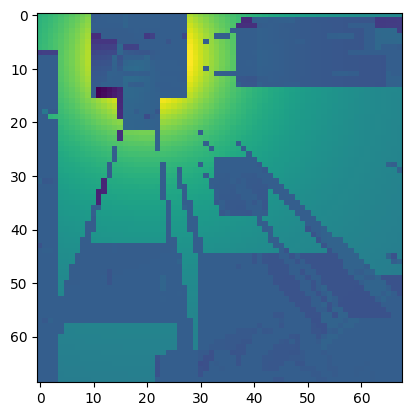

In [14]:
# fig, ax = plt.subplots()
# ax.pcolormesh(np.arange(-32, 37), np.arange(-34, 34), real_parts)
# ax.set_frame_on(False) # remove all spines

plt.imshow(real_parts)



In [15]:
imaginary_parts = np.array(imaginary_parts).reshape(69, 68)

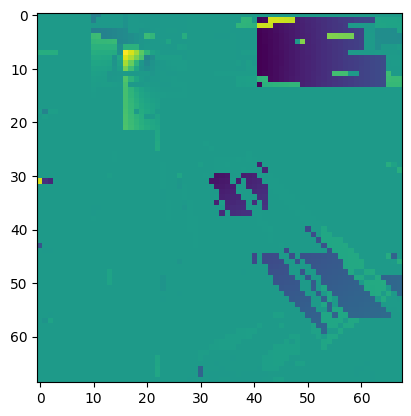

In [16]:
plt.imshow(imaginary_parts)

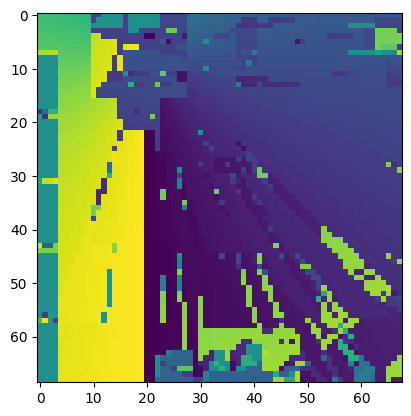

In [17]:
aza = data['Azimuth angle of arrival']
aza = np.array(aza).reshape(69, 68)
plt.imshow(aza)

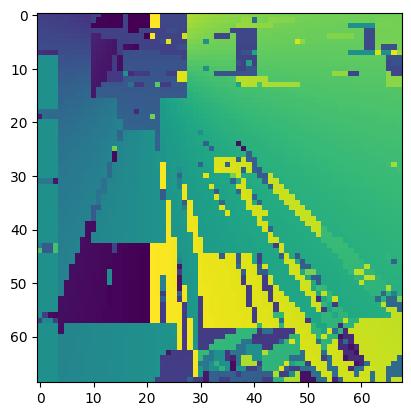

In [18]:
azd = data['Azimuth angle of departure']
azd = np.array(azd).reshape(69, 68)
plt.imshow(azd)

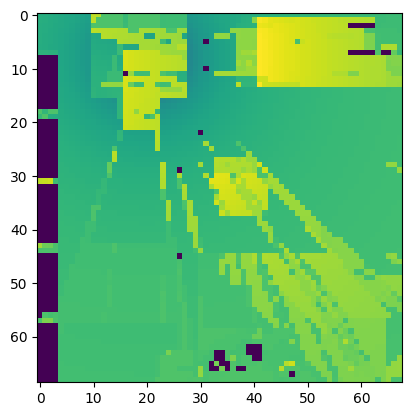

In [19]:
zaa = data['Zenith angle of arrival']
zaa = np.array(zaa).reshape(69, 68)
plt.imshow(zaa)

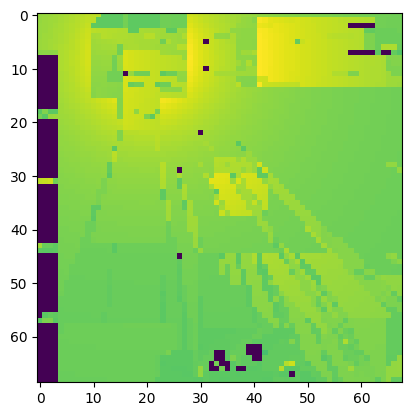

In [20]:
zad = data['Zenith angle of departure']
zad = np.array(zad).reshape(69, 68)
plt.imshow(zad)

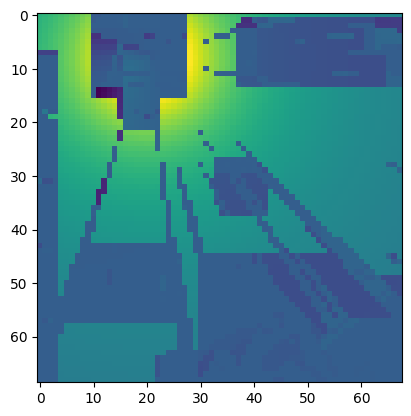

In [21]:
# Real + imaginary
a = real_parts + imaginary_parts
a = np.array(a).reshape(69, 68)
plt.imshow(a)

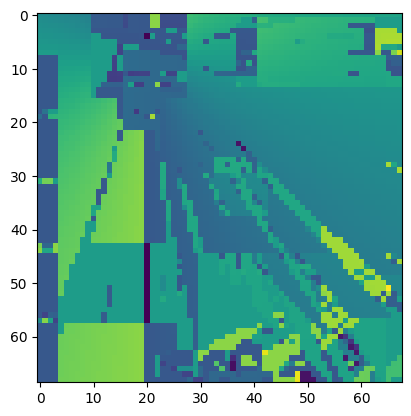

In [22]:
a = real_parts + imaginary_parts + aza + azd + zaa + zad
a = np.array(a).reshape(69, 68)
plt.imshow(a)

In [23]:
a = np.arange(-32, 37)

In [24]:
len(a)

69

In [25]:
# Define a function to extract coordinates
def extract_coordinates(coord_str):
    pattern = r'-?\d+'
    coordinates = re.findall(pattern, coord_str)
    return list(map(int, coordinates))

# Apply the function to create separate columns
data['Source_X'], data['Source_Y'], data['Source_Z'] = zip(*data['Source Coordinate'].apply(extract_coordinates))
data['Target_X'], data['Target_Y'], data['Target_Z'] = zip(*data['Target Coordinate'].apply(extract_coordinates))

# Drop the original coordinate columns
data.drop(columns=['Source Coordinate', 'Target Coordinate'], inplace=True)

In [26]:
data['Target_Y']

0      -34
1      -33
2      -32
3      -31
4      -30
        ..
4687    29
4688    30
4689    31
4690    32
4691    33
Name: Target_Y, Length: 4692, dtype: int64

In [27]:
print("Unique x targets = ",data['Target_X'].nunique())
print("Unique y targets = ",data['Target_Y'].nunique())
print("Total states = ", data['Target_X'].nunique() * data['Target_Y'].nunique())

Unique x targets =  69
Unique y targets =  68
Total states =  4692


In [28]:
print(data['Target_X'].iloc[0] - data['Target_X'].iloc[-1])
print(data['Target_Y'].iloc[0] - data['Target_Y'].iloc[-1])

-68
-67


In [29]:
print("min target X = ", data['Target_X'].iloc[0])
print("max target X = ", data['Target_X'].iloc[-1])
print("min target Y = ", data['Target_Y'].iloc[0])
print("max target Y = ", data['Target_Y'].iloc[-1])

min target X =  -32
max target X =  36
min target Y =  -34
max target Y =  33


In [30]:
action_space = np.array([[-1, 0], [1, 0], [0, 1], [0, -1]])
state_space = []
for i in range(-32, 37):
    for j in range(-34, 34):
        state_space.append([i, j])
state_space = np.array(state_space)
starting_pos = state_space[0]
ending_pos = state_space[-1]


In [31]:
state_space

array([[-32, -34],
       [-32, -33],
       [-32, -32],
       ...,
       [ 36,  31],
       [ 36,  32],
       [ 36,  33]])

In [32]:
# action_prob = {}

# a_values = {}
# for i in action_space:
#     a_values[tuple(i)] = 0.25

# for i in state_space:
#     action_prob[tuple(i)] = a_values
    
# action_prob

### Action Space
#### Action [-1, 0] will take the agent in left direction
#### Action [1, 0] will take the agent in the right direction
#### Action [0, 1] will take the agent in the downward direction
#### Action [0, -1] will take the agent in the upward direction

In [33]:
action_space

array([[-1,  0],
       [ 1,  0],
       [ 0,  1],
       [ 0, -1]])

In [34]:
q_values = {}
q1_values = {}
for i in action_space:
    q1_values[tuple(i)] = 0

for i in state_space:
    q_values[tuple(i)] = q1_values.copy()

In [35]:
# Q values for each state action pair
q_values

{(-32, -34): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -33): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -32): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -31): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -30): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -27): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -26): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -25): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -24): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -23): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -22): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -21): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -20): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -19): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -18): {(-1, 0): 0

In [36]:
cur_x = data['Target_X'].iloc[0]
cur_y = data['Target_Y'].iloc[0]
tar_x = data['Target_X'].iloc[-1]
tar_y = data['Target_Y'].iloc[-1]

In [37]:
print("Source X Coordinate ", cur_x)
print("Source Y Coordinate ", cur_y)
print("Target X Coordinate ", tar_x)
print("Target Y Coordinate ", tar_y)

Source X Coordinate  -32
Source Y Coordinate  -34
Target X Coordinate  36
Target Y Coordinate  33


## Reward function to calculate the reward from the starting position to the target position

In [21]:
# Reward is just the negative of the total distance from the starting position to the target position
def cal_reward(next_x, next_y, tar_x, tar_y):
    return  -abs(abs(tar_x - next_x) + abs(tar_y - next_y))


In [22]:
# def cal_reward1(cur_x, cur_y, tar_x, tar_y):
    
#     if 

In [24]:
def cur_action(action):
    cur_act = {(-1, 0): "left", (1, 0): "right", (0, 1): "down", (0, -1): "up"}    
    return cur_act[action]

# Next state function to give the next state by taking action on the current state
def next_state(cur_x, cur_y, action):
    next_x = cur_x + action[0]
    next_y = cur_y + action[1]

    # Calculating the reward based on the next state
    r = cal_reward(next_x, next_y, tar_x, tar_y)
    
    # Position of the goal
    if next_x == 36 and next_y == 33:
        return 1000, next_x, next_y
    
    # # Position of the obstacle 1
    # if next_x >= -32 and next_x <= 15 and next_y >= -15 and next_y <= 15:
    #     return -1000, cur_x, cur_y

    # # Position of the obstacle 2
    # if next_x >= 20 and next_x <= 36 and next_y >= -15 and next_y <= 15:
    #     return -1000, cur_x, cur_y
    
    # Position inside the grid other than the obstacles
    if next_x >= -32 and next_x <= 36 and next_y >= -34 and next_y <= 33:
        return r, next_x, next_y
    
    # If the agent hits the wall either the x cooridinate will increase or decrease or the y coordinate will increase or decrease
    if next_x < -32 or next_x > 36 or next_y < -34 or next_y > 33:
        return -1000, cur_x, cur_y

    

In [25]:
# This the Q-Learning algorithm for finding the Q values from source to target

alpha = 0.1
discount_factor = 0.9
epsilon = 0.1
reward = 0

def q_learning(start_x, start_y, end_x, end_y, q_values):
    
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    # print(f"Current state = ({cur_x}, {cur_y})")

    while((cur_x, cur_y) != (end_x, end_y)):
        
                
        
        # Taking a random value and checking with the epsilon for deciding whether to take the greedy action or not
        if np.random.uniform() > epsilon: 
            
            # The following line will give the key with the maximum value in the current state
            action = max(q_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)

        else:
            # The following code will give take the random action out of the four actions
            action = random.choice(list(q_values[(cur_x, cur_y)].keys()))


        # print(f"Current action = {action}, {cur_action(action)} ")
                
        # r = cal_reward(cur_x, cur_y, end_x, end_y)
        # print(r)
        
        r, next_x, next_y = next_state(cur_x, cur_y, action)
        rewards.append(r)

        q_values[(cur_x, cur_y)][action] += alpha * (r + discount_factor * max(q_values[(next_x, next_y)].values()) - q_values[(cur_x, cur_y)][action] )
        
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        # print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states
    


In [26]:
q_values

{(-32, -34): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -33): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -32): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -31): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -30): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -27): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -26): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -25): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -24): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -23): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -22): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -21): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -20): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -19): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -18): {(-1, 0): 0

In [27]:
rewards, states = q_learning(cur_x, cur_y, tar_x, tar_y, q_values)

In [28]:
q_values

{(-32, -34): {(-1, 0): -100.0, (1, 0): -25.46, (0, 1): -13.4, (0, -1): -100.0},
 (-32, -33): {(-1, 0): -100.0, (1, 0): -13.3, (0, 1): -13.3, (0, -1): -13.5},
 (-32, -32): {(-1, 0): -100.0,
  (1, 0): -13.200000000000001,
  (0, 1): -13.200000000000001,
  (0, -1): -13.4},
 (-32, -31): {(-1, 0): -100.0,
  (1, 0): -13.100000000000001,
  (0, 1): -13.100000000000001,
  (0, -1): -13.3},
 (-32, -30): {(-1, 0): -100.0,
  (1, 0): -13.0,
  (0, 1): -13.0,
  (0, -1): -13.200000000000001},
 (-32, -29): {(-1, 0): -100.0,
  (1, 0): -12.9,
  (0, 1): -12.9,
  (0, -1): -13.100000000000001},
 (-32, -28): {(-1, 0): -100.0, (1, 0): -12.8, (0, 1): -12.8, (0, -1): -13.0},
 (-32, -27): {(-1, 0): -100.0,
  (1, 0): -12.700000000000001,
  (0, 1): -12.700000000000001,
  (0, -1): -12.9},
 (-32, -26): {(-1, 0): -100.0,
  (1, 0): -12.600000000000001,
  (0, 1): -12.600000000000001,
  (0, -1): -12.8},
 (-32, -25): {(-1, 0): -100.0,
  (1, 0): -12.5,
  (0, 1): -12.5,
  (0, -1): -12.700000000000001},
 (-32, -24): {(-1, 0):

In [29]:
q_values[(36, 33)]

{(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0}

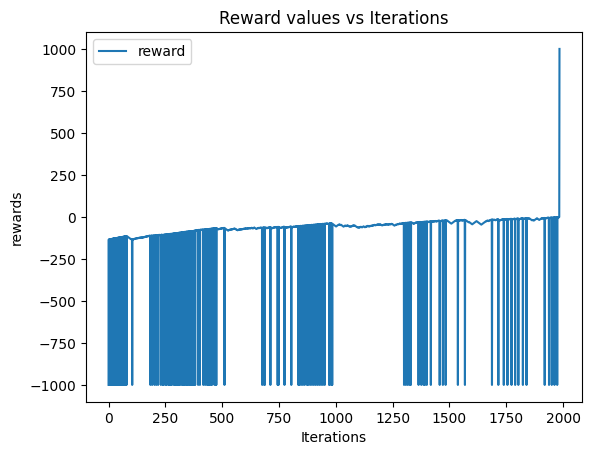

In [30]:
plt.plot(rewards, label = 'reward')

plt.xlabel('Iterations')
plt.ylabel('rewards')
plt.title('Reward values vs Iterations')
plt.legend()
plt.show()

In [67]:
q_values

{(-32, -34): {(-1, 0): -100.0, (1, 0): -13.4, (0, 1): -13.4, (0, -1): 0},
 (-32, -33): {(-1, 0): -100.0,
  (1, 0): -25.270000000000003,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -32): {(-1, 0): -100.0,
  (1, 0): -13.200000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -31): {(-1, 0): -100.0,
  (1, 0): -13.100000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -30): {(-1, 0): -100.0, (1, 0): -13.0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): -100.0, (1, 0): -12.8, (0, 1): -12.8, (0, -1): 0},
 (-32, -27): {(-1, 0): -100.0,
  (1, 0): -12.700000000000001,
  (0, 1): -12.700000000000001,
  (0, -1): 0},
 (-32, -26): {(-1, 0): -100.0,
  (1, 0): -12.600000000000001,
  (0, 1): -12.600000000000001,
  (0, -1): 0},
 (-32, -25): {(-1, 0): -100.0, (1, 0): -12.5, (0, 1): -12.5, (0, -1): 0},
 (-32, -24): {(-1, 0): -100.0, (1, 0): -12.4, (0, 1): -12.4, (0, -1): 0},
 (-32, -23): {(-1, 0): -100.0, (1, 0): -12.3, (0, 1): -12.3, (0, -1): 0},
 (-32, -22): 

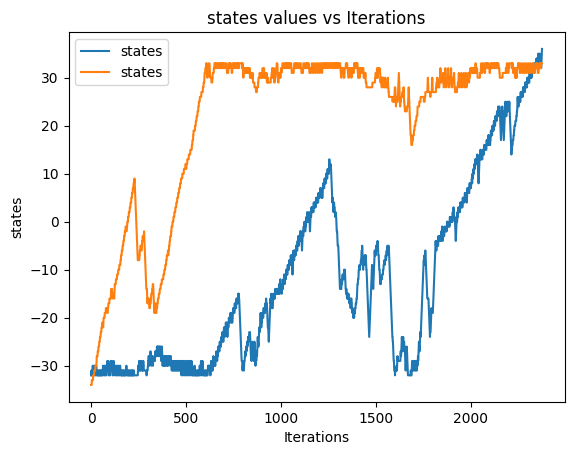

In [68]:
plt.plot(states, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

In [69]:
print("The current state the agent has reached is ", states[-1])
print("The reward at this stage is ", rewards[-1])

The current state the agent has reached is  (36, 33)
The reward at this stage is  1000


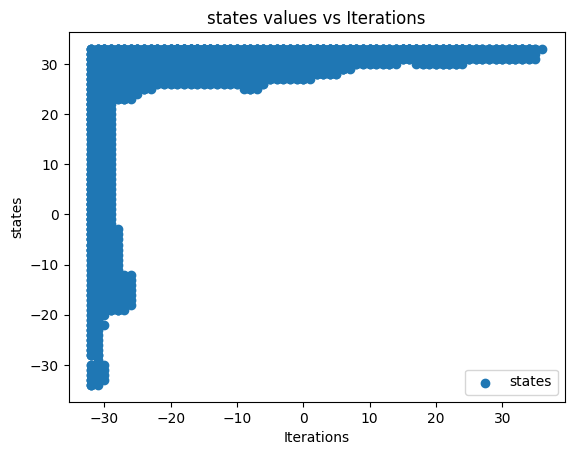

In [70]:
#Plotting the states
states1, states2 = zip(*states)
plt.scatter(states1, states2, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

In [72]:
# fig = plt.figure()
# plt.xlim(-34, 40)
# plt.ylim(-36, 36)
# graph, = plt.plot([], [], 'o')

# def animate(i):
#     graph.set_data(states1[i:i+1], states2[i:i+1])
#     return graph

# ani = FuncAnimation(fig, animate, frames=len(states1), interval=10)
# plt.show()
# ani.save('q_learning.gif', writer = 'pillow')

In [73]:
q_values

{(-32, -34): {(-1, 0): -100.0, (1, 0): -13.4, (0, 1): -13.4, (0, -1): 0},
 (-32, -33): {(-1, 0): -100.0,
  (1, 0): -25.270000000000003,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -32): {(-1, 0): -100.0,
  (1, 0): -13.200000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -31): {(-1, 0): -100.0,
  (1, 0): -13.100000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -30): {(-1, 0): -100.0, (1, 0): -13.0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): -100.0, (1, 0): -12.8, (0, 1): -12.8, (0, -1): 0},
 (-32, -27): {(-1, 0): -100.0,
  (1, 0): -12.700000000000001,
  (0, 1): -12.700000000000001,
  (0, -1): 0},
 (-32, -26): {(-1, 0): -100.0,
  (1, 0): -12.600000000000001,
  (0, 1): -12.600000000000001,
  (0, -1): 0},
 (-32, -25): {(-1, 0): -100.0, (1, 0): -12.5, (0, 1): -12.5, (0, -1): 0},
 (-32, -24): {(-1, 0): -100.0, (1, 0): -12.4, (0, 1): -12.4, (0, -1): 0},
 (-32, -23): {(-1, 0): -100.0, (1, 0): -12.3, (0, 1): -12.3, (0, -1): 0},
 (-32, -22): 

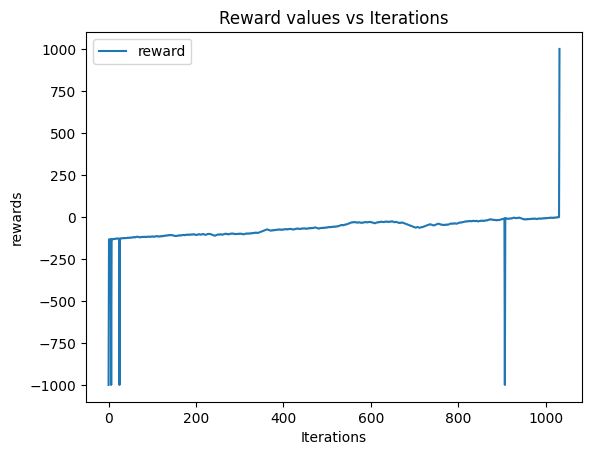

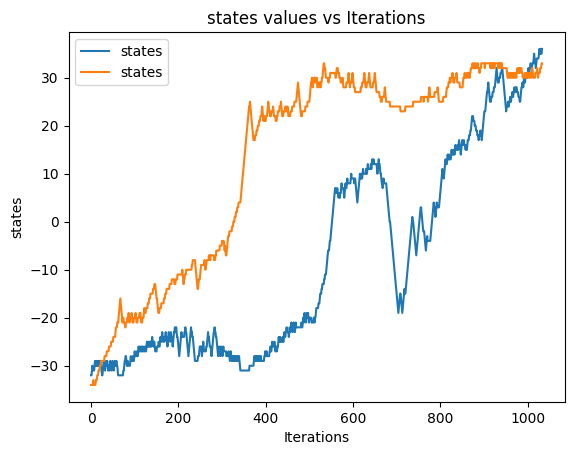

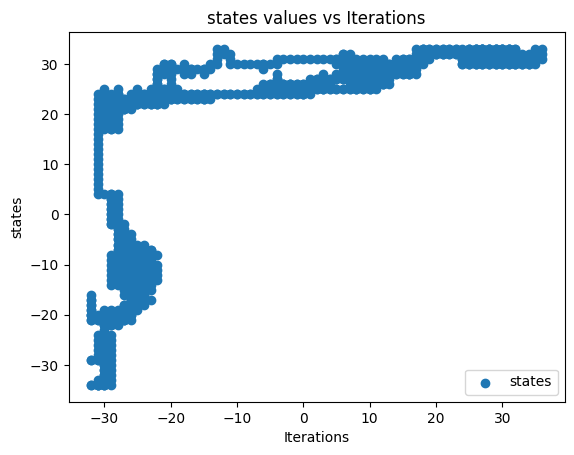

In [74]:
rewards, states = q_learning(cur_x, cur_y, tar_x, tar_y, q_values)

# Plotting the reward
plt.plot(rewards, label = 'reward')
plt.xlabel('Steps')
plt.ylabel('rewards')
plt.title('Reward values vs Steps')
plt.legend()
plt.show()


#Plotting the two coordinates of the states
plt.plot(states, label = 'states')

plt.xlabel('Iterations')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

#Plotting the states
states1, states2 = zip(*states)
plt.scatter(states1, states2, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

In [75]:
def q_learned(start_x, start_y, end_x, end_y, q_values):
    
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    print(f"Current state = ({cur_x}, {cur_y})")

    while((cur_x, cur_y) != (end_x, end_y)):
                  
        # The following line will give the key with the maximum value in the current state
        action = max(q_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)


        print(f"Current action = {action}, {cur_action(action)} ")
                
        r, next_x, next_y = next_state(cur_x, cur_y, action)
        rewards.append(r)
       
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states
    

In [76]:
q_values[(-32, 33)] # Down left corner

{(-1, 0): -100.0, (1, 0): -6.7, (0, 1): -100.0, (0, -1): -6.9}

In [77]:
q_values[(36, -34)] # top right corner

{(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0}

In [78]:
q_values[(-32, -34)] # Top left corner

{(-1, 0): -100.0, (1, 0): -25.46, (0, 1): -13.4, (0, -1): -100.0}

In [79]:
rewards, states = q_learned(cur_x, cur_y, tar_x, tar_y, q_values)

Current state = (-32, -34)
Current action = (0, 1), down 
Current state = (-32, -33)
Current action = (0, 1), down 
Current state = (-32, -32)
Current action = (0, 1), down 
Current state = (-32, -31)
Current action = (0, 1), down 
Current state = (-32, -30)
Current action = (0, 1), down 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, -1), up 
Current state = (-32

KeyboardInterrupt: 

## The following cell is to run the q_learning for many iterations

In [80]:
# Training the q_values for many iterations (episodes)
for i in range(100000):
    rewards, states = q_learning(cur_x, cur_y, tar_x, tar_y, q_values)

In [81]:
q_values[((-32, 33))]

{(-1, 0): -1100.2186840220315,
 (1, 0): -579.2178369645529,
 (0, 1): -1304.230298318456,
 (0, -1): -586.0725813605095}

In [82]:
q_values[((36, -34))]

{(-1, 0): -574.05629414755,
 (1, 0): -1124.8526741530877,
 (0, 1): -569.1309386427204,
 (0, -1): -1214.3643252316008}

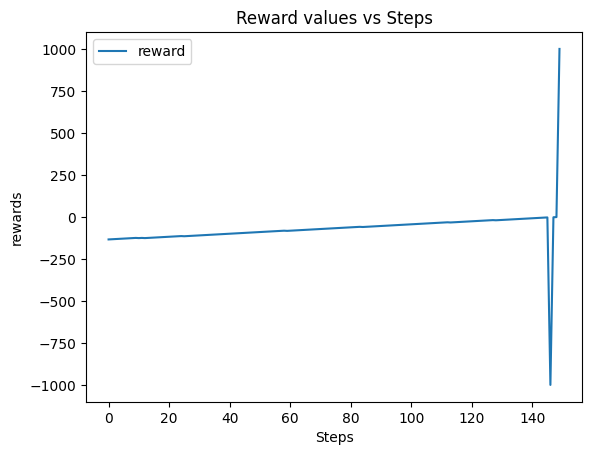

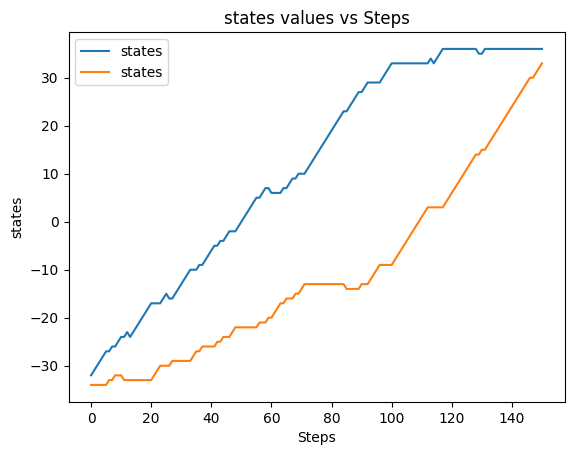

In [83]:
# Plotting the rewards
plt.plot(rewards, label = 'reward')

plt.xlabel('Steps')
plt.ylabel('rewards')
plt.title('Reward values vs Steps')
plt.legend()
plt.show()


#Plotting the states
plt.plot(states, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

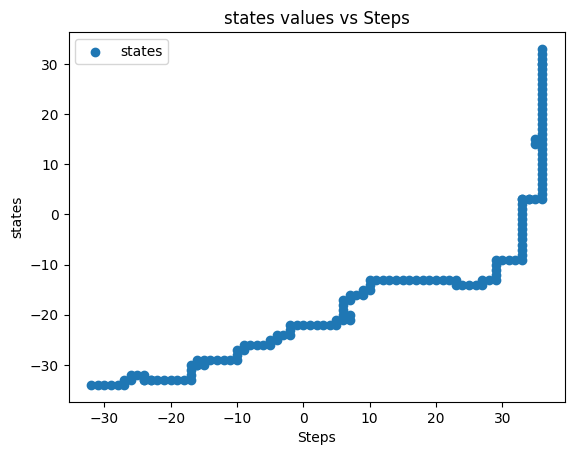

In [84]:
#Plotting the states
states1, states2 = zip(*states)
plt.scatter(states1, states2, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()


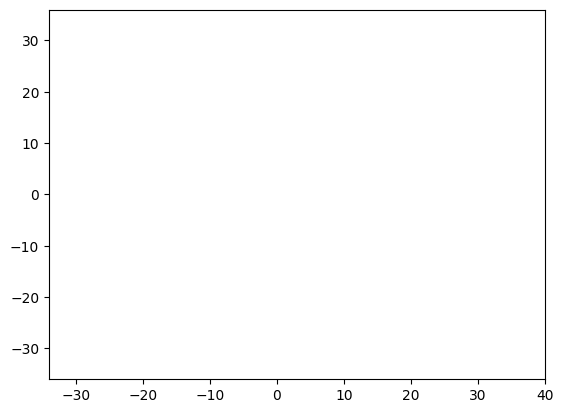

In [88]:
fig = plt.figure()
plt.xlim(-34, 40)
plt.ylim(-36, 36)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(states1[i:i+1], states2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=len(states1), interval=10)
plt.show()
ani.save('q_learning.gif', writer = 'pillow')

## Running the q_learned function

In [86]:
rewards, states = q_learned(cur_x, cur_y, tar_x, tar_y, q_values)

Current state = (-32, -34)
Current action = (0, 1), down 
Current state = (-32, -33)
Current action = (0, 1), down 
Current state = (-32, -32)
Current action = (0, 1), down 
Current state = (-32, -31)
Current action = (0, 1), down 
Current state = (-32, -30)
Current action = (0, 1), down 
Current state = (-32, -29)
Current action = (0, 1), down 
Current state = (-32, -28)
Current action = (0, 1), down 
Current state = (-32, -27)
Current action = (0, 1), down 
Current state = (-32, -26)
Current action = (0, 1), down 
Current state = (-32, -25)
Current action = (0, 1), down 
Current state = (-32, -24)
Current action = (0, 1), down 
Current state = (-32, -23)
Current action = (0, 1), down 
Current state = (-32, -22)
Current action = (0, 1), down 
Current state = (-32, -21)
Current action = (0, 1), down 
Current state = (-32, -20)
Current action = (0, 1), down 
Current state = (-32, -19)
Current action = (0, 1), down 
Current state = (-32, -18)
Current action = (0, 1), down 
Current state 

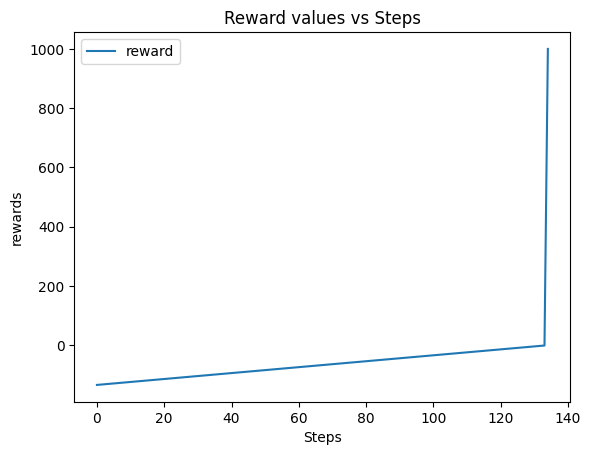

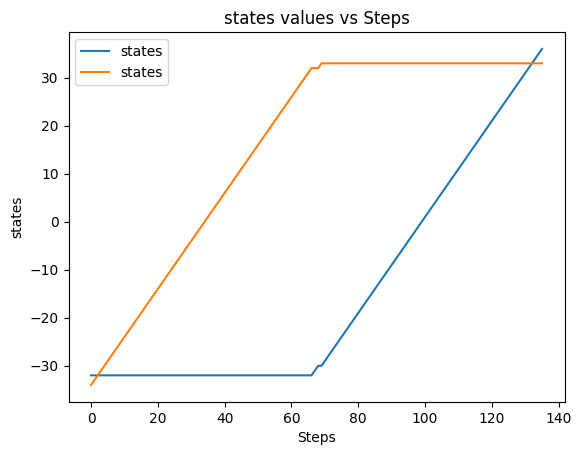

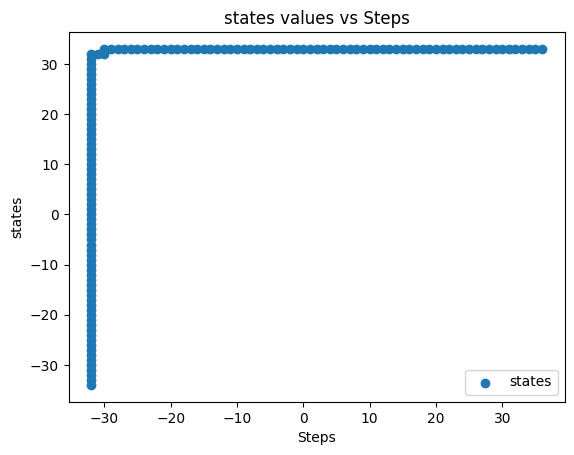

In [87]:
# Plotting the graphs for the q_learned function
# Plotting the rewards
plt.plot(rewards, label = 'reward')

plt.xlabel('Steps')
plt.ylabel('rewards')
plt.title('Reward values vs Steps')
plt.legend()
plt.show()


#Plotting the states
plt.plot(states, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

#Plotting the states
states1, states2 = zip(*states)
plt.scatter(states1, states2, label = 'states')

plt.xlabel('Steps')
plt.ylabel('states')
plt.title('states values vs Steps')
plt.legend()
plt.show()

In [ ]:
#Plotting the animated graph for the q_learned function
fig = plt.figure()
plt.xlim(-34, 40)
plt.ylim(-36, 36)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(states1[i:i+1], states2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=len(states1), interval=10)
plt.show()
ani.save('q_learned.gif', writer = 'pillow')

## Q Learning with obstacle

In [126]:
cur_x = data['Target_X'].iloc[0]
cur_y = data['Target_Y'].iloc[0]
tar_x = data['Target_X'].iloc[-1]
tar_y = data['Target_Y'].iloc[-1]

In [127]:
# Reward is just the negative of the total distance from the starting position to the target position
def cal_reward(next_x, next_y, tar_x, tar_y):
    return  -((tar_x - next_x) ** 2 + (tar_y - next_y) ** 2)

def cur_action(action):
    cur_act = {(-1, 0): "left", (1, 0): "right", (0, 1): "down", (0, -1): "up"}    
    return cur_act[action]



In [128]:
q_values_obstacles = {}
q1_values = {}
for i in action_space:
    q1_values[tuple(i)] = 0

for i in state_space:
    q_values_obstacles[tuple(i)] = q1_values.copy()

In [129]:
q_values_obstacles

{(-32, -34): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -33): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -32): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -31): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -30): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -27): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -26): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -25): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -24): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -23): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -22): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -21): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -20): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -19): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -18): {(-1, 0): 0

In [130]:
# Next state function to give the next state by taking action on the current state
def next_state_obstacles(cur_x, cur_y, action):
    next_x = cur_x + action[0]
    next_y = cur_y + action[1]

    # Calculating the reward based on the next state
    r = cal_reward(next_x, next_y, tar_x, tar_y)
    
    # Position of the goal
    if next_x == 36 and next_y == 33:
        return 100000, next_x, next_y
    
    # Position of the obstacle 1
    if next_x >= -32 and next_x <= 25 and next_y >= -15 and next_y <= 15:
        return -100000, cur_x, cur_y

    # Position of the obstacle 2
    if next_x >= 30 and next_x <= 36 and next_y >= -15 and next_y <= 15:
        return -100000, cur_x, cur_y
    
    # Position inside the grid other than the obstacles
    if next_x >= -32 and next_x <= 36 and next_y >= -34 and next_y <= 33:
        return r, next_x, next_y
    
    # If the agent hits the wall either the x cooridinate will increase or decrease or the y coordinate will increase or decrease
    if next_x < -32 or next_x > 36 or next_y < -34 or next_y > 33:
        return -100000, cur_x, cur_y

In [131]:
# This the Q-Learning algorithm for finding the Q values from source to target

alpha = 0.1
discount_factor = 0.9
epsilon = 0.1
reward = 0

def q_learning_obstacles(start_x, start_y, end_x, end_y, q_values):
    
    collision = 0
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    # print(f"Current state = ({cur_x}, {cur_y})")

    while((cur_x, cur_y) != (end_x, end_y)):
        
                
        
        # Taking a random value and checking with the epsilon for deciding whether to take the greedy action or not
        if np.random.uniform() > epsilon: 
            
            # The following line will give the key with the maximum value in the current state
            action = max(q_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)

        else:
            # The following code will give take the random action out of the four actions
            action = random.choice(list(q_values[(cur_x, cur_y)].keys()))


        # print(f"Current action = {action}, {cur_action(action)} ")
                
        # r = cal_reward(cur_x, cur_y, end_x, end_y)
        # print(r)
        
        r, next_x, next_y = next_state_obstacles(cur_x, cur_y, action)
        rewards.append(r)
        if r == -100000:
            collision += 1

        q_values[(cur_x, cur_y)][action] += alpha * (r + discount_factor * max(q_values[(next_x, next_y)].values()) - q_values[(cur_x, cur_y)][action] )
        
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        # print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states, collision
    


In [132]:
avg_rewards = []
collisions = []

In [133]:
rewardsf, states, collision = q_learning_obstacles(cur_x, cur_y, tar_x, tar_y, q_values_obstacles)
collisions.append(collision)
avg_rewards.append(np.mean(rewardsf))

In [134]:
q_values_obstacles

{(-32, -34): {(-1, 0): -10000.0,
  (1, 0): -1705.8200000000002,
  (0, 1): -898.0,
  (0, -1): -10000.0},
 (-32, -33): {(-1, 0): -10000.0,
  (1, 0): -884.5,
  (0, 1): -884.9000000000001,
  (0, -1): -911.3000000000001},
 (-32, -32): {(-1, 0): -10000.0,
  (1, 0): -871.4000000000001,
  (0, 1): 0,
  (0, -1): -898.0},
 (-32, -31): {(-1, 0): -19000.0, (1, 0): -858.5, (0, 1): 0, (0, -1): 0},
 (-32, -30): {(-1, 0): -10000.0,
  (1, 0): -845.8000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -29): {(-1, 0): -10000.0,
  (1, 0): -833.3000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -28): {(-1, 0): -19000.0, (1, 0): -821.0, (0, 1): 0, (0, -1): 0},
 (-32, -27): {(-1, 0): -10000.0,
  (1, 0): -808.9000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -26): {(-1, 0): -10000.0, (1, 0): -797.0, (0, 1): 0, (0, -1): 0},
 (-32, -25): {(-1, 0): -10000.0,
  (1, 0): -785.3000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -24): {(-1, 0): -10000.0,
  (1, 0): -773.8000000000001,
  (0, 1): 0,
  (0, -1): 0},
 (-32, -23): 

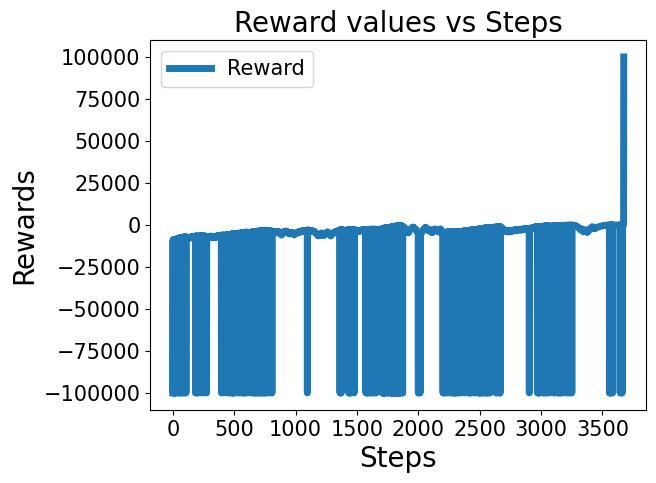

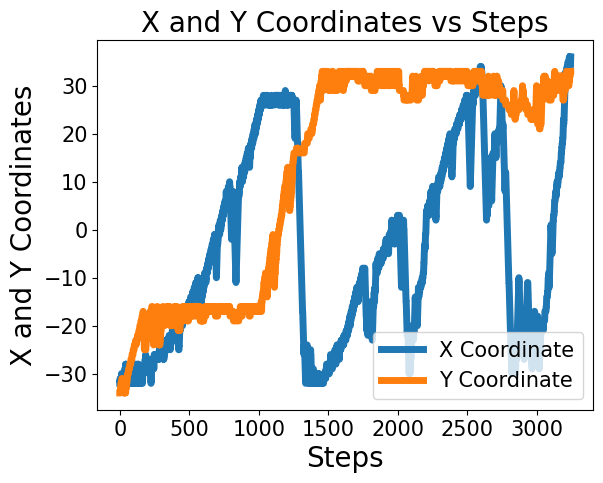

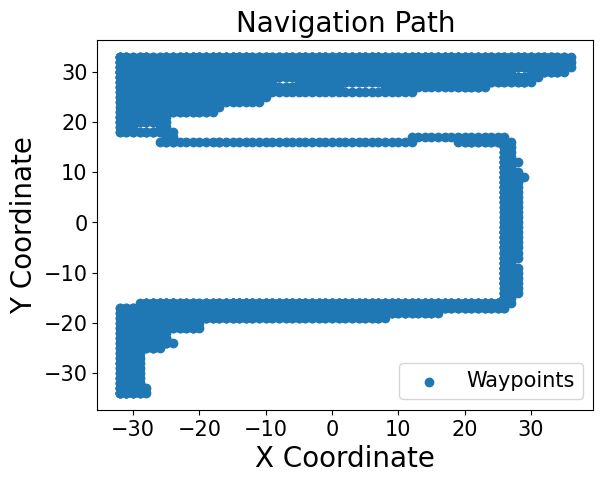

In [135]:
# Plotting the graphs for the q_learing function
# Plotting the rewards
plt.plot(rewards, label = 'Reward', linewidth = 5)

plt.xlabel('Steps', fontsize = 20)
plt.ylabel('Rewards', fontsize = 20)
plt.title('Reward values vs Steps', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

states1, states2 = zip(*states)
#Plotting the states
plt.plot(states1, label = 'X Coordinate', linewidth = 5)
plt.plot(states2, label = 'Y Coordinate', linewidth = 5)

plt.xlabel('Steps', fontsize = 20)
plt.ylabel('X and Y Coordinates', fontsize = 20)
plt.title('X and Y Coordinates vs Steps', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

#Plotting the states
plt.scatter(states1, states2, label = 'Waypoints')

plt.xlabel('X Coordinate', fontsize = 20)
plt.ylabel('Y Coordinate', fontsize = 20)
plt.title('Navigation Path', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

## Learning the q values with obstacles with many iterations

In [136]:
# Training the q_values for many iterations (episodes)
for i in range(10000):
    rewardsi, statesi, collision = q_learning_obstacles(cur_x, cur_y, tar_x, tar_y, q_values_obstacles)
    collisions.append(collision)
    avg_rewards.append(np.mean(rewardsi))

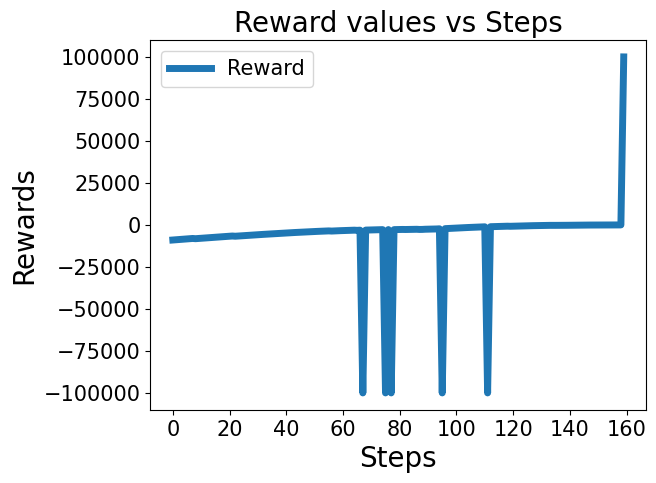

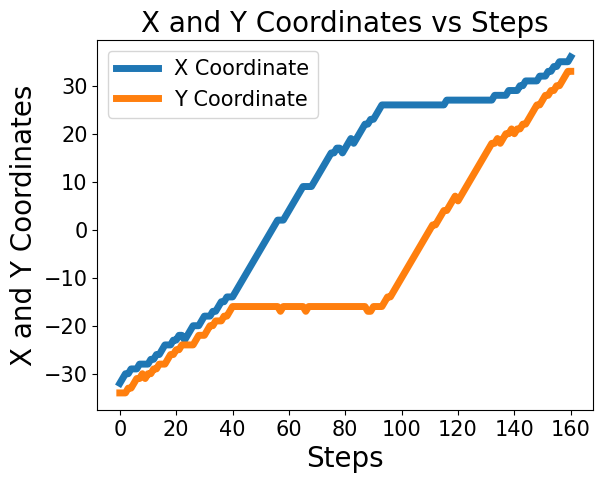

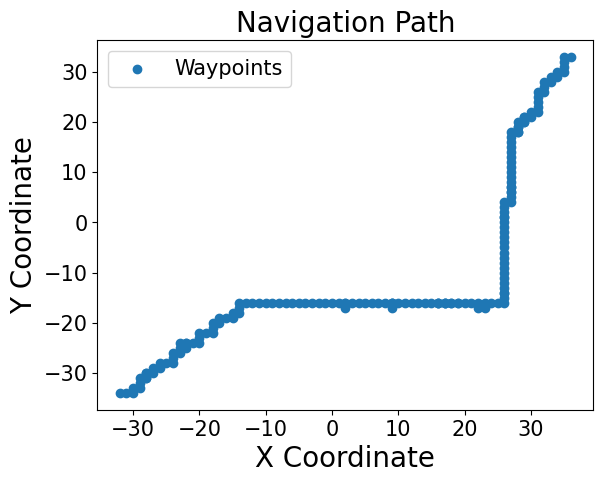

In [137]:
# Plotting the graphs for the q_learing function
# Plotting the rewards
plt.plot(rewardsi, label = 'Reward', linewidth = 5)

plt.xlabel('Steps', fontsize = 20)
plt.ylabel('Rewards', fontsize = 20)
plt.title('Reward values vs Steps', fontsize = 20)
plt.xticks(fontsize= 15)
plt.yticks(fontsize= 15)
plt.legend(fontsize= 15)
plt.show()

statesi1, statesi2 = zip(*statesi)
#Plotting the states
plt.plot(statesi1, label = 'X Coordinate', linewidth = 5)
plt.plot(statesi2, label = 'Y Coordinate', linewidth = 5)
plt.xlabel('Steps', fontsize = 20)
plt.ylabel('X and Y Coordinates', fontsize = 20)
plt.title('X and Y Coordinates vs Steps', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

#Plotting the states
plt.scatter(statesi1, statesi2, label = 'Waypoints')
plt.xlabel('X Coordinate', fontsize = 20)
plt.ylabel('Y Coordinate', fontsize = 20)
plt.title('Navigation Path', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

### Plotting average rewards per iteration and collisions per iterations

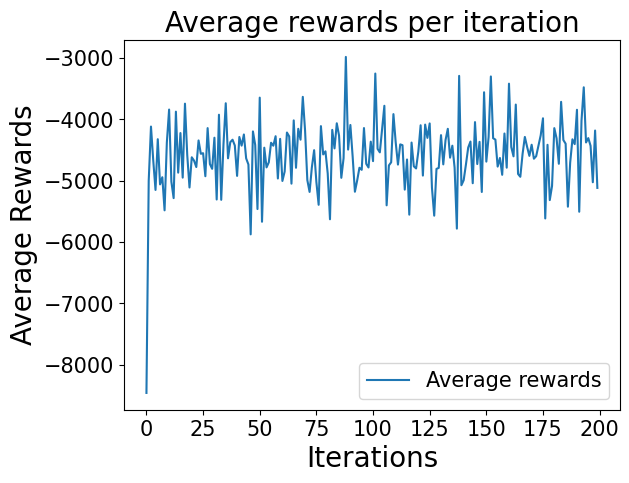

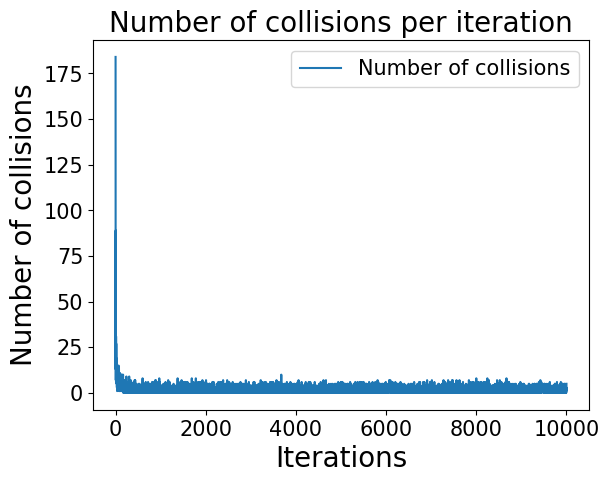

In [147]:
plt.plot(avg_rewards[:200], label = 'Average rewards')

plt.xlabel('Iterations', fontsize = 20)
plt.ylabel('Average Rewards', fontsize = 20)
plt.title('Average rewards per iteration', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize = 15)
plt.show()

plt.plot(collisions, label = 'Number of collisions')

plt.xlabel('Iterations', fontsize = 20)
plt.ylabel('Number of collisions', fontsize = 20)
plt.title('Number of collisions per iteration', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize = 15)
plt.show()


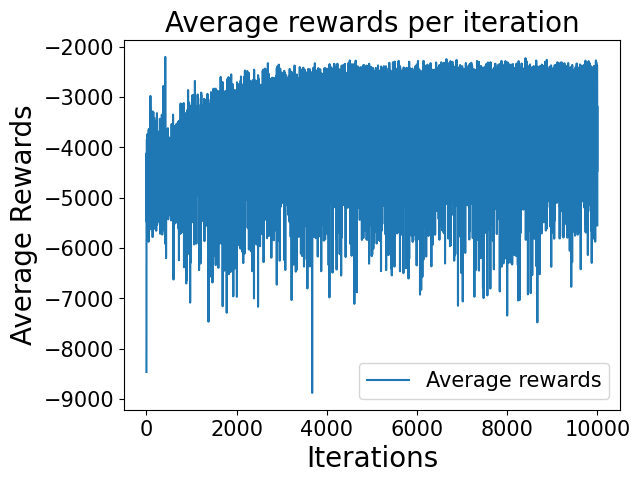

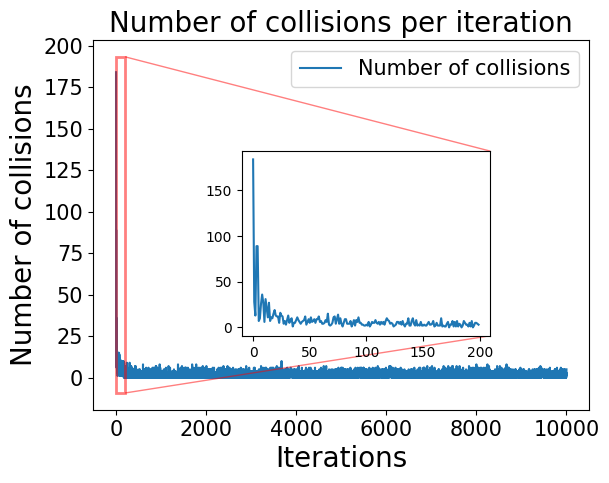

In [172]:
plt.plot(avg_rewards, label = 'Average rewards')

plt.xlabel('Iterations', fontsize = 20)
plt.ylabel('Average Rewards', fontsize = 20)
plt.title('Average rewards per iteration', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize = 15)
plt.show()


fig, ax = plt.subplots()

ax.plot(collisions, label = 'Number of collisions')
collision1 = collisions[:200]
zm = ax.inset_axes([0.3, 0.2, 0.5, 0.5])
zm.plot(collision1)
ax.indicate_inset_zoom(zm, edgecolor = 'red', lw = 2)
plt.xlabel('Iterations', fontsize = 20)
plt.ylabel('Number of collisions', fontsize = 20)
plt.title('Number of collisions per iteration', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize = 15)
plt.show()


In [175]:
start_time = time.time()
rewards_learned, states, collision_learned = q_learned(cur_x, cur_y, tar_x, tar_y, q_values_obstacles)
print("Time = ", time.time() - start_time)

Current state = (-32, -34)
Current action = (1, 0), right 
Current state = (-31, -34)
Current action = (1, 0), right 
Current state = (-30, -34)
Current action = (0, 1), down 
Current state = (-30, -33)
Current action = (1, 0), right 
Current state = (-29, -33)
Current action = (0, 1), down 
Current state = (-29, -32)
Current action = (0, 1), down 
Current state = (-29, -31)
Current action = (1, 0), right 
Current state = (-28, -31)
Current action = (0, 1), down 
Current state = (-28, -30)
Current action = (1, 0), right 
Current state = (-27, -30)
Current action = (0, 1), down 
Current state = (-27, -29)
Current action = (1, 0), right 
Current state = (-26, -29)
Current action = (0, 1), down 
Current state = (-26, -28)
Current action = (1, 0), right 
Current state = (-25, -28)
Current action = (1, 0), right 
Current state = (-24, -28)
Current action = (0, 1), down 
Current state = (-24, -27)
Current action = (0, 1), down 
Current state = (-24, -26)
Current action = (1, 0), right 
Curre

In [141]:
print("Average Reward for the path followed after learning = ", np.mean(rewards_learned))
print("Number of collisions after learning the path = ", collision_learned)

Average Reward for the path followed after learning =  -2411.177777777778
Number of collisions after learning the path =  0


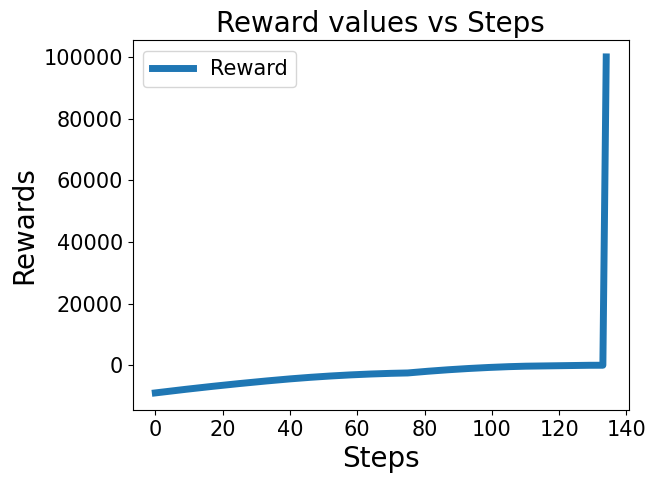

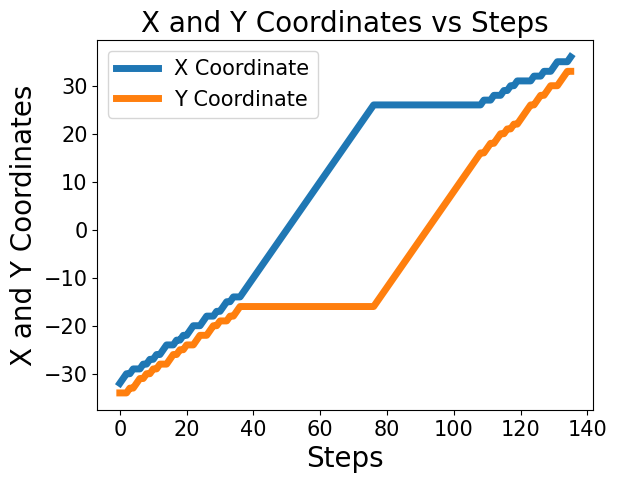

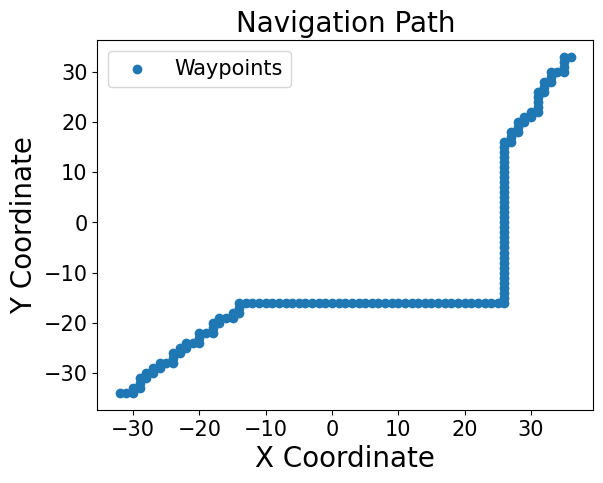

In [144]:
# Plotting the graphs for the q_learing function
# Plotting the rewards
plt.plot(rewards_learned, label = 'Reward', linewidth = 5)

plt.xlabel('Steps', fontsize = 20)
plt.ylabel('Rewards', fontsize = 20)
plt.title('Reward values vs Steps', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

states1, states2 = zip(*states)
#Plotting the states
plt.plot(states1, label = 'X Coordinate', linewidth = 5)
plt.plot(states2, label = 'Y Coordinate', linewidth = 5)
plt.xlabel('Steps', fontsize = 20)
plt.ylabel('X and Y Coordinates', fontsize = 20)
plt.title('X and Y Coordinates vs Steps', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

#Plotting the states
plt.scatter(states1, states2, label = 'Waypoints')

plt.xlabel('X Coordinate', fontsize = 20)
plt.ylabel('Y Coordinate', fontsize = 20)
plt.title('Navigation Path', fontsize = 20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(fontsize=15)
plt.show()

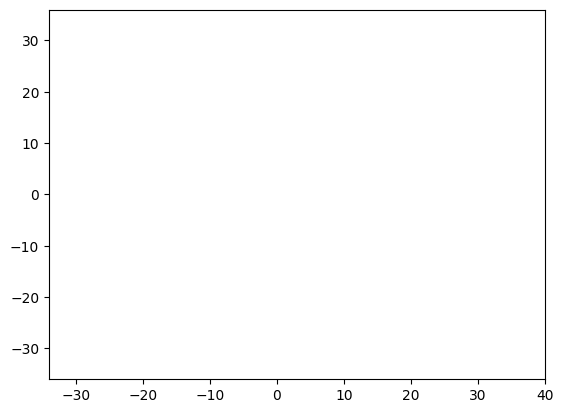

In [65]:
fig = plt.figure()
plt.xlim(-34, 40)
plt.ylim(-36, 36)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(states1[i:i+1], states2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=len(states1), interval=10)
plt.show()
ani.save('q_learning_with_obstacle.gif', writer = 'pillow')

## Reward function from the starting position to the end position, with the collision reward and the target reward
### Obstactles are assumed to be at from (2, 2) to (-2,-2)
### Obstacles are given a reward of -4000 and target is given a reward of 1000


In [44]:
cur_x = 2
cur_y = 2
tar_x = -2
tar_y = -2

In [45]:
q_values_obstacles = {}
q1_values = {}
for i in action_space:
    q1_values[tuple(i)] = 0

for i in state_space:
    q_values_obstacles[tuple(i)] = q1_values.copy()

q_values_obstacles

{(-32, -34): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -33): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -32): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -31): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -30): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -29): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -28): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -27): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -26): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -25): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -24): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -23): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -22): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -21): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -20): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -19): {(-1, 0): 0, (1, 0): 0, (0, 1): 0, (0, -1): 0},
 (-32, -18): {(-1, 0): 0

## Running with just one iteration

In [46]:
rewards, states = q_learning_obstacles(cur_x, cur_y, tar_x, tar_y, q_values_obstacles)

KeyboardInterrupt: 

In [42]:

# Reward is just the negative of the total distance from the starting position to the target position
def cal_reward1(cur_x, cur_y, tar_x, tar_y):
    
    if (cur_x < 2) and cur_x > -2 and cur_y < 2 and cur_y > -2:
        return -4000
    if cur_x == 36 and cur_y == 33:
        return 1000
    
    return  -abs(abs(tar_x-cur_x) + abs(tar_y - tar_x))
    

In [43]:
# This the Q-Learning algorithm for finding the Q values from source to target

alpha = 0.1
discount_factor = 0.9
epsilon = 0.1
reward = 0

def q1_learning(start_x, start_y, end_x, end_y, q_values):
    
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    print(f"Current state = ({cur_x}, {cur_y})")

    i = 0
    while((cur_x, cur_y) != (end_x, end_y)):
        
                
        
        # Taking a random value and checking with the epsilon for deciding whether to take the greedy action or not
        if np.random.uniform() > epsilon: 
            
            # The following line will give the key with the maximum value in the current state
            action = max(q_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)

        else:
            # The following code will give take the random action out of the four actions
            action = random.choice(list(q_values[(cur_x, cur_y)].keys()))


        print(f"Current action = {action}, {cur_action(action)} ")
                
        r = cal_reward1(cur_x, cur_y, end_x, end_y)
        print(r)
        rewards.append(r)
        
        next_x, next_y = next_state(cur_x, cur_y, action)
        
        q_values[(cur_x, cur_y)][action] += alpha * (r + discount_factor * max(q_values[(next_x, next_y)].values()) - q_values[(cur_x, cur_y)][action] )
        
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states
    


In [46]:
q2_values = {}
q1_values = {}
for i in action_space:
    q2_values[tuple(i)] = 0

for i in state_space:
    q1_values[tuple(i)] = q2_values

In [90]:
# q1_values

In [91]:
# rewards, states = q1_learning(cur_x, cur_y, tar_x, tar_y, q1_values)

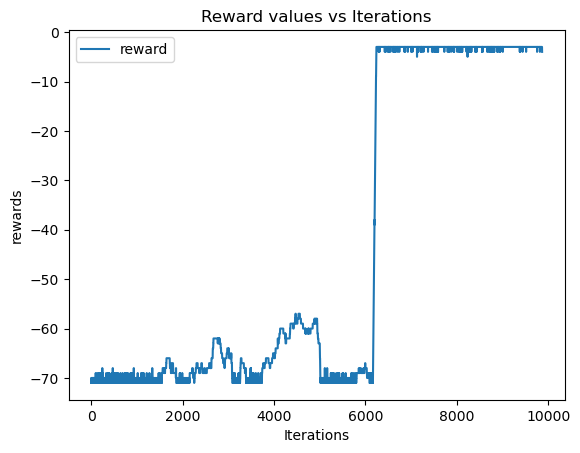

In [49]:
plt.plot(rewards, label = 'reward')

plt.xlabel('Iterations')
plt.ylabel('rewards')
plt.title('Reward values vs Iterations')
plt.legend()
plt.show()

In [92]:
# q1_values

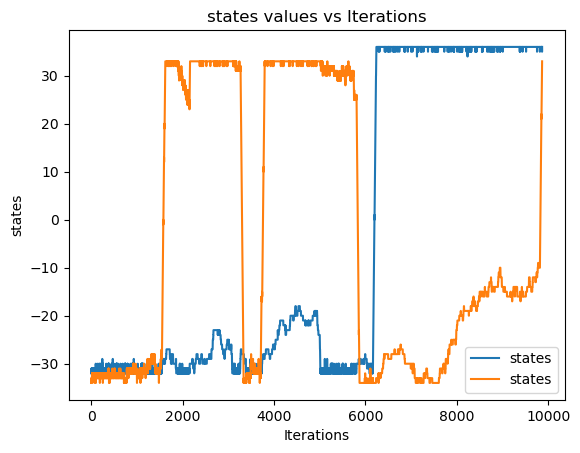

In [52]:
plt.plot(states, label = 'states')

plt.xlabel('Iterations')
plt.ylabel('states')
plt.title('states values vs Iterations')
plt.legend()
plt.show()

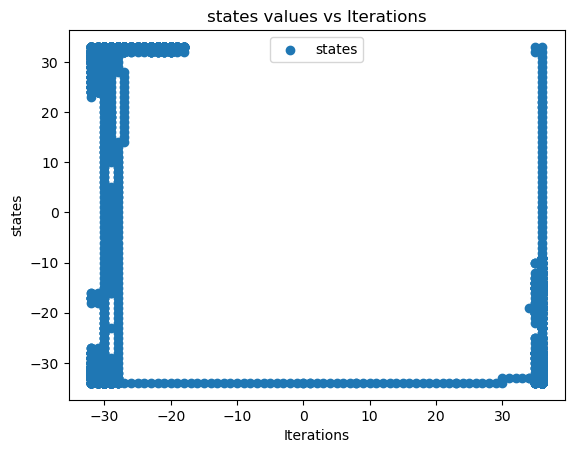

In [53]:
#Plotting the states
states1, states2 = zip(*states)
plt.scatter(states1, states2, label = 'states')

plt.xlabel('Iterations')
plt.ylabel('states')
plt.title('states values vs Iterations')
plt.legend()
plt.show()


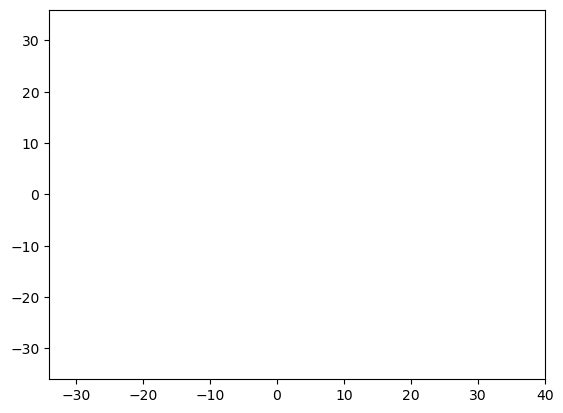

In [54]:
fig = plt.figure()
plt.xlim(-34, 40)
plt.ylim(-36, 36)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(states1[i:i+1], states2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=len(states1), interval=10)
plt.show()
ani.save('q_learning_with_obstacle.gif', writer = 'pillow')

## Learning the q learning with obstacles for 10 iterations

In [93]:
# for i in range(10):
#     rewards, states = q1_learning(cur_x, cur_y, tar_x, tar_y, q1_values)

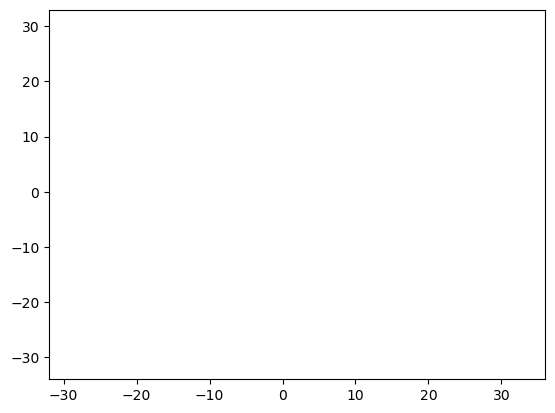

In [386]:

fig = plt.figure()
plt.xlim(-32, 36)
plt.ylim(-34, 33)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(sa1[i:i+1], sa2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=1000, interval=200)
plt.show()
ani.save('12.gif', writer = 'pillow')

In [59]:
def q_learned(start_x, start_y, end_x, end_y, q_values):
    
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    print(f"Current state = ({cur_x}, {cur_y})")

    while((cur_x, cur_y) != (end_x, end_y)):
                  
        # The following line will give the key with the maximum value in the current state
        action = max(q_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)


        print(f"Current action = {action}, {cur_action(action)} ")
                
        r = cal_reward(cur_x, cur_y, end_x, end_y)
        print(r)
        rewards.append(r)
        
        next_x, next_y = next_state(cur_x, cur_y, action)
                
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states
    

In [96]:
# rewards, states = q_learned(cur_x, cur_y, tar_x, tar_y, q_values)

In [95]:
# q_values

In [63]:
def q_learned1(start_x, start_y, end_x, end_y, q1_values):
    
    rewards = []
    states = []
    
    cur_x = start_x
    cur_y = start_y
    states.append((cur_x, cur_y))
    print(f"Current state = ({cur_x}, {cur_y})")

    while((cur_x, cur_y) != (end_x, end_y)):
                  
        # The following line will give the key with the maximum value in the current state
        action = max(q1_values[(cur_x, cur_y)], key = q_values[(cur_x, cur_y)].get)


        print(f"Current action = {action}, {cur_action(action)} ")
                
        r = cal_reward1(cur_x, cur_y, end_x, end_y)
        print(r)
        rewards.append(r)
        
        next_x, next_y = next_state(cur_x, cur_y, action)
                
        cur_x, cur_y = next_x, next_y
        states.append((cur_x, cur_y))
        print(f"Current state = ({cur_x}, {cur_y})")
        
    return rewards, states
    

In [94]:
# rewards, states = q_learned1(cur_x, cur_y, tar_x, tar_y, q1_values)

In [395]:
sa1 = states1[-100:]
sa2 = states2[-100:]

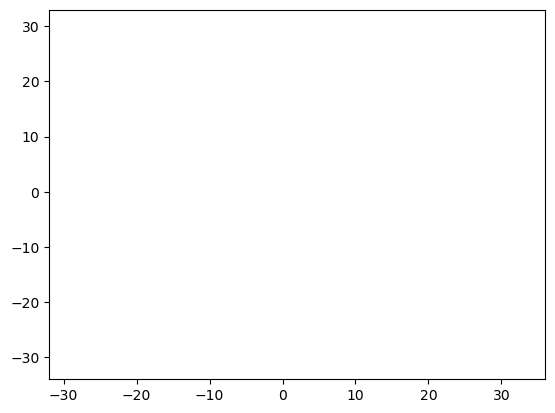

In [400]:
fig = plt.figure()
plt.xlim(-32, 36)
plt.ylim(-34, 33)
graph, = plt.plot([], [], 'o')

def animate(i):
    graph.set_data(sa1[i:i+1], sa2[i:i+1])
    return graph

ani = FuncAnimation(fig, animate, frames=100, interval=100)
plt.show()
ani.save('2.gif', writer = 'pillow')